# Import Libraries

In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sklearn.preprocessing import PowerTransformer
import scipy.stats as stats

import warnings 
warnings.filterwarnings("ignore")

from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import mean_absolute_error as mae

from urllib.request import urlopen
import json

# Read Files from the data given

In [2]:
xls = pd.ExcelFile('cdc_diabetes_2018.xlsx')

df1 = pd.read_excel(xls, 'Diabetes')
df2 = pd.read_excel(xls, 'Obesity')
df3 = pd.read_excel(xls, 'Inactivity')

# Data Overview

In [3]:
df1.head()

,YEAR,FIPS,COUNTY,STATEW,% DIABETIC
0,2018,1001,Autauga County,Alabama,9.5
1,2018,1003,Baldwin County,Alabama,8.4
2,2018,1005,Barbour County,Alabama,13.5
3,2018,1007,Bibb County,Alabama,10.2
4,2018,1009,Blount County,Alabama,10.5


In [4]:
df2.head()

,YEAR,FIPS,COUNTY,STATE,% OBESE
0,2018,1011,Bullock County,Alabama,18.7
1,2018,2068,Denali Borough,Alaska,18.9
2,2018,2105,Hoonah-Angoon Census Area,Alaska,19.4
3,2018,2195,Petersburg Census Area,Alaska,17.2
4,2018,2230,Skagway Municipality,Alaska,18.3


In [5]:
df3.head()

,YEAR,FIPDS,COUNTY,STATE,% INACTIVE
0,2018,1011,Bullock County,Alabama,17.0
1,2018,1029,Cleburne County,Alabama,19.3
2,2018,1037,Coosa County,Alabama,16.8
3,2018,1063,Greene County,Alabama,16.8
4,2018,2013,Aleutians East Borough,Alaska,19.2


# Check for missing values

In [6]:
print("\nDiabetes")
print(df1.isnull().sum())
print("\nObesity")
print(df2.isnull().sum())
print("\nInactive")
print(df3.isnull().sum())


Diabetes
YEAR          0
FIPS          0
COUNTY        0
STATEW        0
% DIABETIC    0
dtype: int64

Obesity
YEAR       0
FIPS       0
COUNTY     0
STATE      0
% OBESE    0
dtype: int64

Inactive
YEAR          0
FIPDS         0
COUNTY        0
STATE         0
% INACTIVE    0
dtype: int64


# Data Statistics

In [7]:
print("\nDiabetes")
df1.describe()


Diabetes


,YEAR,FIPS,% DIABETIC
count,3142.0,3142.000000,3142.000000
mean,2018.0,30383.649268,8.719796
std,0.0,15162.508374,1.794854
min,2018.0,1001.000000,3.800000
25%,2018.0,18177.500000,7.300000
50%,2018.0,29176.000000,8.400000
75%,2018.0,45080.500000,9.700000
max,2018.0,56045.000000,17.900000


In [8]:
print("\nObesity")
df2.describe()


Obesity


,YEAR,FIPS,% OBESE
count,363.0,363.000000,363.000000
mean,2018.0,33817.906336,18.264738
std,0.0,16810.094056,1.038311
min,2018.0,1011.000000,10.500000
25%,2018.0,17020.000000,17.900000
50%,2018.0,46061.000000,18.300000
75%,2018.0,48262.000000,19.000000
max,2018.0,56039.000000,19.500000


In [9]:
print("\nInactive")
df3.describe()


Inactive


,YEAR,FIPDS,% INACTIVE
count,1370.0,1370.000000,1370.000000
mean,2018.0,32715.840876,16.543358
std,0.0,15891.407141,1.926010
min,2018.0,1011.000000,8.800000
25%,2018.0,18076.000000,15.000000
50%,2018.0,35012.000000,16.700000
75%,2018.0,48196.500000,18.100000
max,2018.0,56039.000000,19.500000


 # Features dtypes

In [10]:
print("\nDiabetes")
df1.info()


Diabetes
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3142 entries, 0 to 3141
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   YEAR        3142 non-null   int64  
 1   FIPS        3142 non-null   int64  
 2   COUNTY      3142 non-null   object 
 3   STATEW      3142 non-null   object 
 4   % DIABETIC  3142 non-null   float64
dtypes: float64(1), int64(2), object(2)
memory usage: 122.9+ KB


In [11]:
print("Obesity")
df2.info()

Obesity
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 363 entries, 0 to 362
Data columns (total 5 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   YEAR     363 non-null    int64  
 1   FIPS     363 non-null    int64  
 2   COUNTY   363 non-null    object 
 3   STATE    363 non-null    object 
 4   % OBESE  363 non-null    float64
dtypes: float64(1), int64(2), object(2)
memory usage: 14.3+ KB


In [12]:
print("\nInactive")
df3.info()


Inactive
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1370 entries, 0 to 1369
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   YEAR        1370 non-null   int64  
 1   FIPDS       1370 non-null   int64  
 2   COUNTY      1370 non-null   object 
 3   STATE       1370 non-null   object 
 4   % INACTIVE  1370 non-null   float64
dtypes: float64(1), int64(2), object(2)
memory usage: 53.6+ KB


# Shape of Data

In [13]:
print('The total shape of the Diabetes data is: ',df1.shape)
print('The total shape of the Obesity data is: ',df2.shape)
print('The total shape of the Inactive starter data is: ',df3.shape)


The total shape of the Diabetes data is:  (3142, 5)
The total shape of the Obesity data is:  (363, 5)
The total shape of the Inactive starter data is:  (1370, 5)


# Correlation values

In [14]:
corr_matrix = df1.corr()
fig = px.imshow(corr_matrix, color_continuous_scale='blues', title="Feature Correlation Matrix - Diabetes")
fig.show()

In [15]:
corr_matrix = df2.corr()
fig = px.imshow(corr_matrix, color_continuous_scale='blues', title="Feature Correlation Matrix - Obesity")
fig.show()

In [16]:
corr_matrix = df3.corr()
fig = px.imshow(corr_matrix, color_continuous_scale='blues', title="Feature Correlation Matrix - Inactive")
fig.show()

# Exploratory Data Analysis

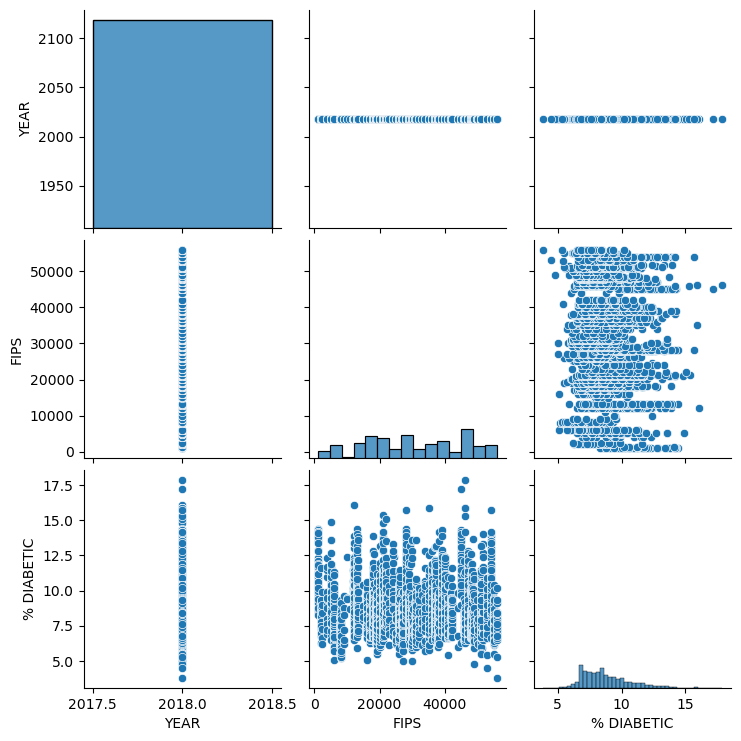

In [17]:
sns.pairplot(df1)

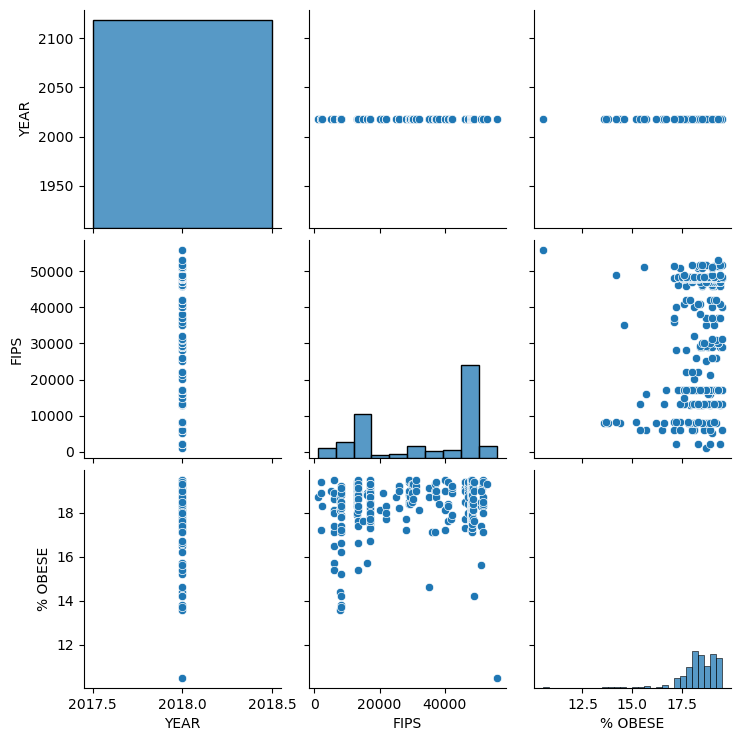

In [18]:
sns.pairplot(df2)

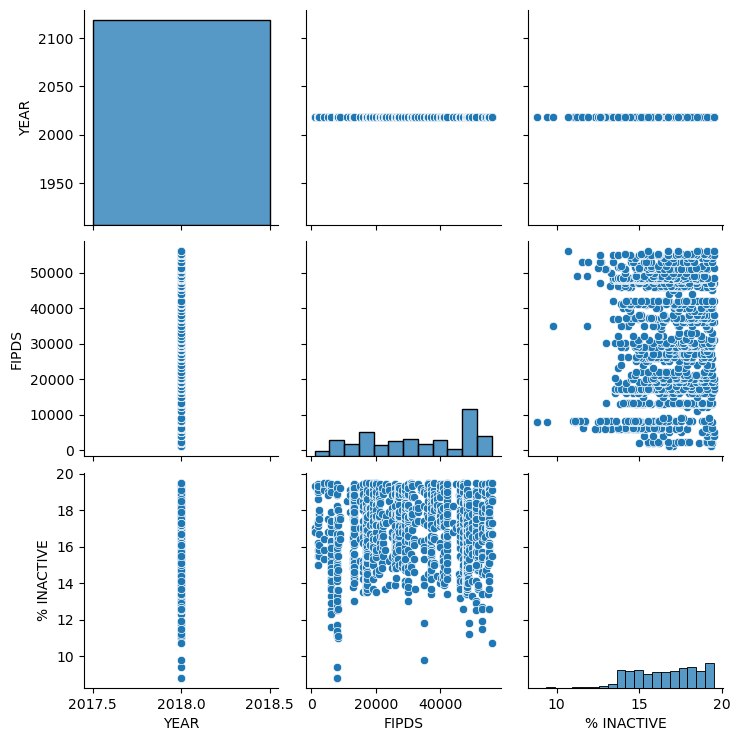

In [19]:
sns.pairplot(df3)

### Diabetes - Correlation Matrix

In [20]:
df1.corr()

,YEAR,FIPS,% DIABETIC
YEAR,NaN,NaN,NaN
FIPS,NaN,1.000000,-0.083521
% DIABETIC,NaN,-0.083521,1.000000


## Obesity - Correlation Matrix

In [21]:
df2.corr()

,YEAR,FIPS,% OBESE
YEAR,NaN,NaN,NaN
FIPS,NaN,1.000000,0.112354
% OBESE,NaN,0.112354,1.000000


## Inactive - Correlation Matrix

In [22]:
df3.corr()

,YEAR,FIPDS,% INACTIVE
YEAR,NaN,NaN,NaN
FIPDS,NaN,1.00000,-0.06312
% INACTIVE,NaN,-0.06312,1.00000


# Box Plot

In [23]:
def plot_box_plots(df):
    numeric_columns = df.select_dtypes(include=[pd.np.number])
    sns.set(style="whitegrid")
    num_features = numeric_columns.shape[1]
    num_rows = (num_features + 2) // 3
    num_cols = min(num_features, 3)

    # Create a figure with subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))

    # Flatten the axes if there's only one row
    if num_rows == 1:
        axes = axes.reshape(1, -1)

    # Loop through the columns and plot box plots
    for i, col in enumerate(numeric_columns.columns):
        row_index = i // num_cols
        col_index = i % num_cols

        ax = axes[row_index, col_index]

        sns.boxplot(x=df[col], ax=ax)
        ax.set_title(f'Box Plot of {col}')
        ax.set_xlabel(col)

    # Remove any empty subplots
    for i in range(num_features, num_rows * num_cols):
        fig.delaxes(axes.flatten()[i])

    # Adjust the layout and display the plots
    plt.tight_layout()
    plt.show()

Box Plot for Diabetes Data


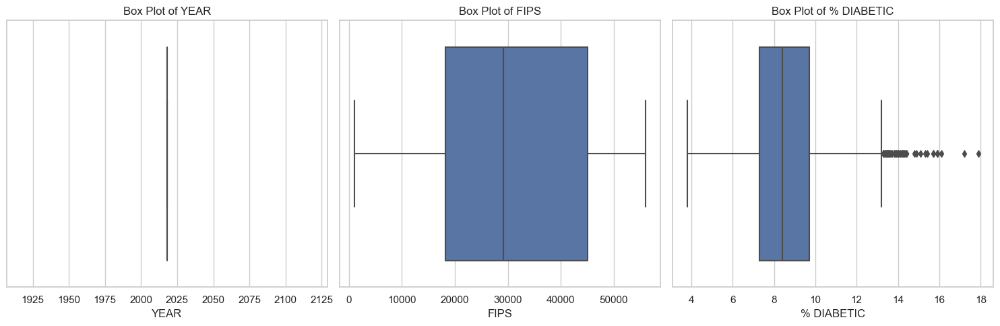

In [24]:
print("Box Plot for Diabetes Data")
plot_box_plots(df1)

Box Plot for Obesity Data


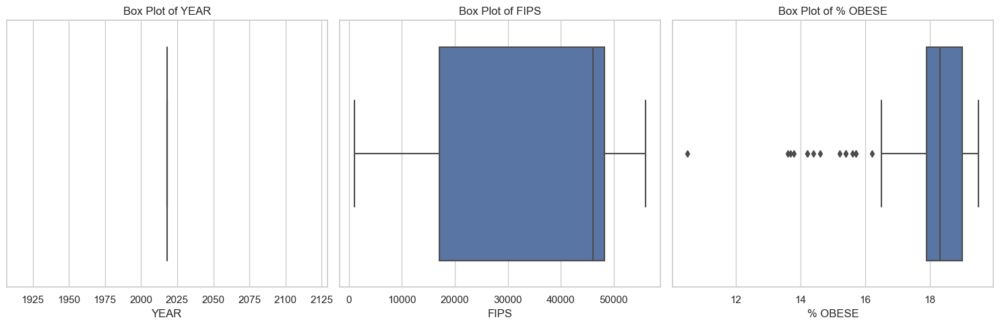

In [25]:
print("Box Plot for Obesity Data")
plot_box_plots(df2)

Box Plot for Inactive Data


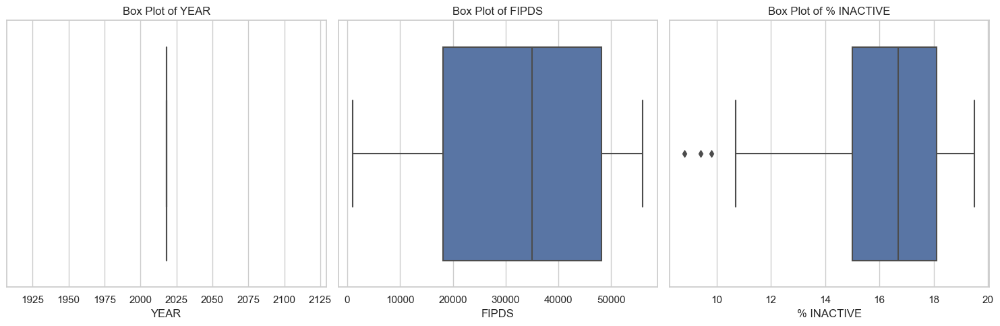

In [26]:
print("Box Plot for Inactive Data")
plot_box_plots(df3)

# Histogram

In [27]:
fig = px.histogram(df1["% DIABETIC"], log_y=True, title='Histogram of % DIABETIC (log scale)')
fig.update_layout(yaxis_type='log')
fig.show()

In [28]:
fig = px.histogram(df2["% OBESE"], log_y=True, title='Histogram of % OBESITY (log scale)')
fig.update_layout(yaxis_type='log')
fig.show()

In [29]:
fig = px.histogram(df3["% INACTIVE"], log_y=True, title='Histogram of % INACTIVE (log scale)')
fig.update_layout(yaxis_type='log')
fig.show()

# Unique State in diabetic 

In [30]:
df1['STATEW'].nunique() , df1['STATEW'].unique()

(51,
 array(['Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California',
        'Colorado', 'Connecticut', 'Delaware', 'District of Columbia',
        'Florida', 'Georgia', 'Hawaii', 'Idaho', 'Illinois', 'Indiana',
        'Iowa', 'Kansas', 'Kentucky', 'Louisiana', 'Maine', 'Maryland',
        'Massachusetts', 'Michigan', 'Minnesota', 'Mississippi',
        'Missouri', 'Montana', 'Nebraska', 'Nevada', 'New Hampshire',
        'New Jersey', 'New Mexico', 'New York', 'North Carolina',
        'North Dakota', 'Ohio', 'Oklahoma', 'Oregon', 'Pennsylvania',
        'Rhode Island', 'South Carolina', 'South Dakota', 'Tennessee',
        'Texas', 'Utah', 'Vermont', 'Virginia', 'Washington',
        'West Virginia', 'Wisconsin', 'Wyoming'], dtype=object))

# Unique State in obesity 

In [31]:
df2['STATE'].nunique() , df2['STATE'].unique()

(33,
 array(['Alabama', 'Alaska', 'Arkansas', 'California', 'Colorado',
        'Georgia', 'Hawaii', 'Idaho', 'Illinois', 'Kansas', 'Kentucky',
        'Louisiana', 'Massachusetts', 'Michigan', 'Mississippi',
        'Missouri', 'Montana', 'Nebraska', 'Nevada', 'New Mexico',
        'New York', 'North Carolina', 'North Dakota', 'Oklahoma', 'Oregon',
        'Pennsylvania', 'South Dakota', 'Tennessee', 'Texas', 'Utah',
        'Virginia', 'Washington', 'Wyoming'], dtype=object))

# Unique State in Inactivity

In [32]:
df3['STATE'].nunique() , df3['STATE'].unique()

(50,
 array(['Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California',
        'Colorado', 'Connecticut', 'District of Columbia', 'Florida',
        'Georgia', 'Hawaii', 'Idaho', 'Illinois', 'Indiana', 'Iowa',
        'Kansas', 'Kentucky', 'Louisiana', 'Maine', 'Maryland',
        'Massachusetts', 'Michigan', 'Minnesota', 'Mississippi',
        'Missouri', 'Montana', 'Nebraska', 'Nevada', 'New Hampshire',
        'New Jersey', 'New Mexico', 'New York', 'North Carolina',
        'North Dakota', 'Ohio', 'Oklahoma', 'Oregon', 'Pennsylvania',
        'Rhode Island', 'South Carolina', 'South Dakota', 'Tennessee',
        'Texas', 'Utah', 'Vermont', 'Virginia', 'Washington',
        'West Virginia', 'Wisconsin', 'Wyoming'], dtype=object))

# Let's Check differences by State for % DIABETIC

In [33]:
sort_std = df1.groupby(['STATEW']).describe()['% DIABETIC'].sort_values('std').index

each_state = df1.groupby(['STATEW']).describe()['% DIABETIC'].sort_values('std')

each_state

,count,mean,std,min,25%,50%,75%,max
STATEW,,,,,,,,
Illinois,102.0,7.552941,0.736153,6.3,7.000,7.35,8.000,9.6
Massachusetts,14.0,7.378571,0.789526,6.2,6.750,7.45,8.000,8.3
Vermont,14.0,7.378571,0.880715,6.2,6.700,7.40,7.850,9.3
Minnesota,87.0,7.811494,0.908029,5.0,7.150,7.80,8.400,9.9
Wisconsin,72.0,7.480556,0.969484,5.5,6.800,7.30,8.025,10.4
Colorado,64.0,6.845313,0.984794,5.2,6.000,6.80,7.500,9.3
Hawaii,5.0,8.740000,1.001499,7.9,8.100,8.40,8.900,10.4
Pennsylvania,67.0,8.350746,1.041760,6.7,7.500,8.40,9.100,11.6
Iowa,99.0,7.906061,1.106458,5.5,7.050,7.80,8.600,11.2


# Top 5

## For Illinois

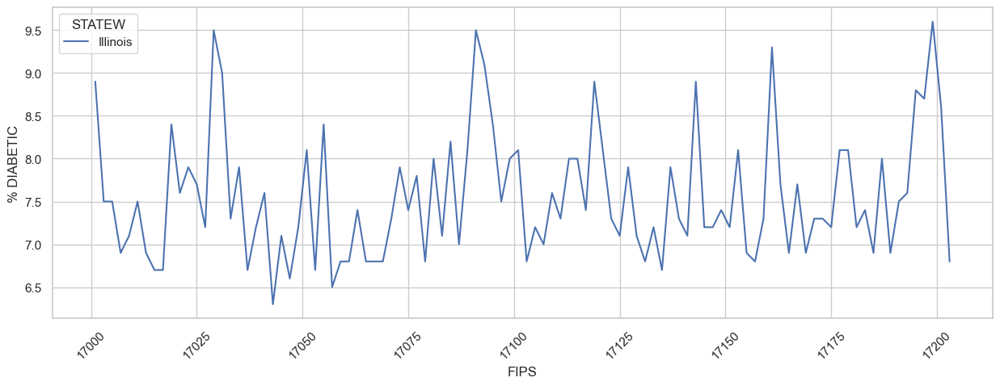

In [34]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df1[df1['STATEW'].isin(['Illinois'])], x='FIPS',y='% DIABETIC', hue='STATEW')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

## For Massachusetts

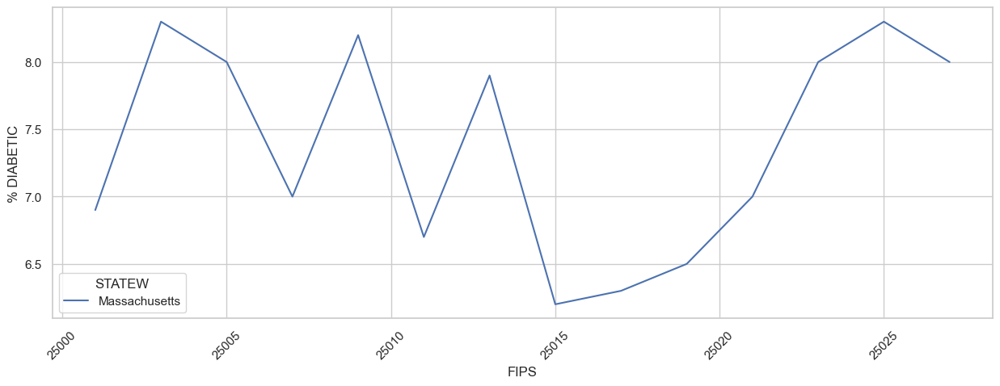

In [35]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df1[df1['STATEW'].isin(['Massachusetts'])], x='FIPS',y='% DIABETIC', hue='STATEW')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

## For Vermont

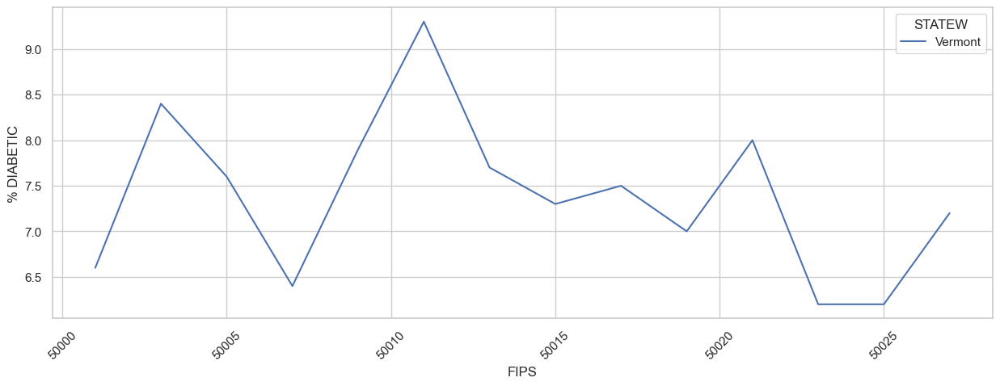

In [36]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df1[df1['STATEW'].isin(['Vermont'])], x='FIPS',y='% DIABETIC', hue='STATEW')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

## For Minnesota

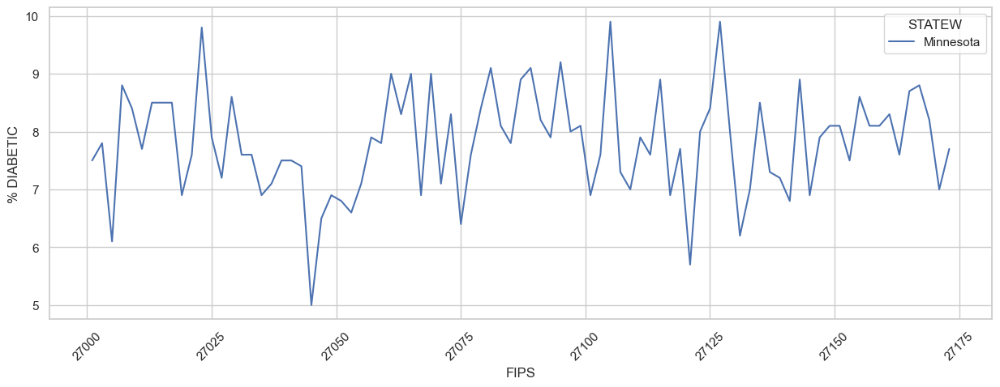

In [37]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df1[df1['STATEW'].isin(['Minnesota'])], x='FIPS',y='% DIABETIC', hue='STATEW')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

## For Wisconsin

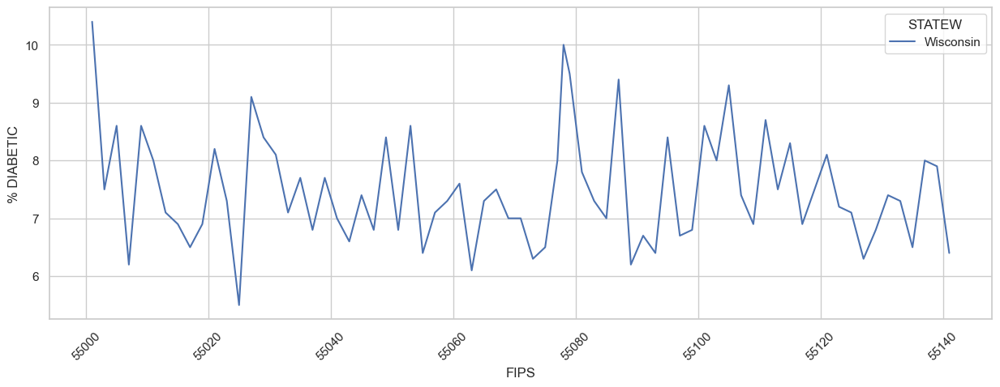

In [38]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df1[df1['STATEW'].isin(['Wisconsin'])], x='FIPS',y='% DIABETIC', hue='STATEW')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

# Bottom 5

## For Florida

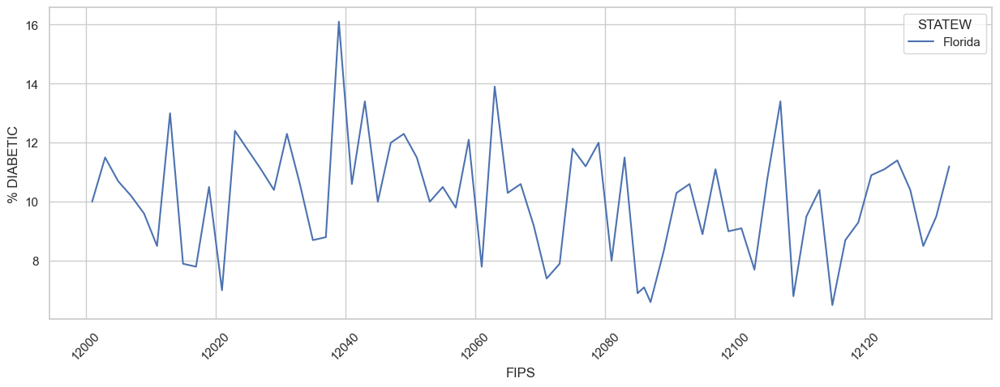

In [39]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df1[df1['STATEW'].isin(['Florida'])], x='FIPS',y='% DIABETIC', hue='STATEW')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

## For Maryland

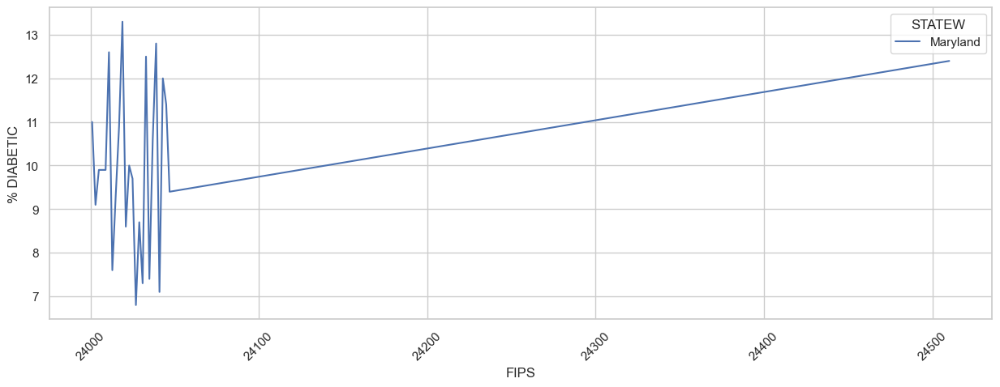

In [40]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df1[df1['STATEW'].isin(['Maryland'])], x='FIPS',y='% DIABETIC', hue='STATEW')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

## For Kentucky

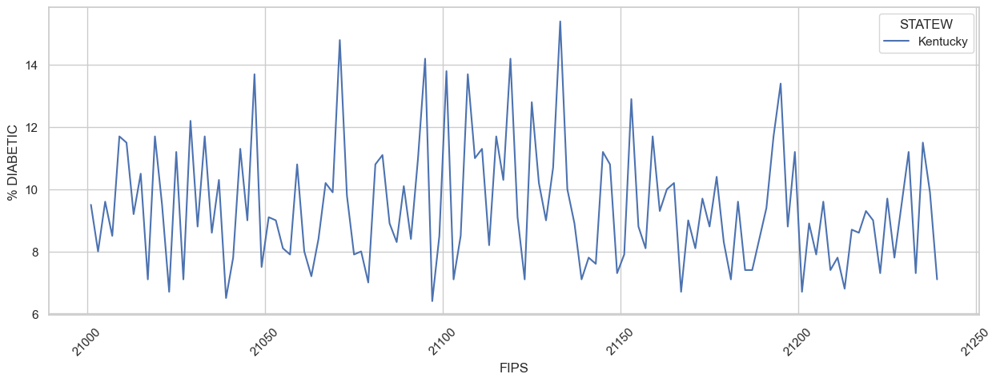

In [41]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df1[df1['STATEW'].isin(['Kentucky'])], x='FIPS',y='% DIABETIC', hue='STATEW')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

## For New Mexico

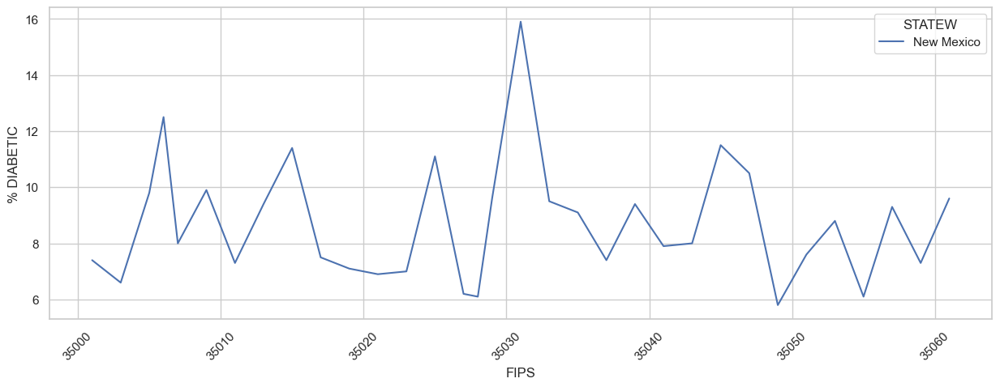

In [42]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df1[df1['STATEW'].isin(['New Mexico'])], x='FIPS',y='% DIABETIC', hue='STATEW')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

## For SOuth Dakota

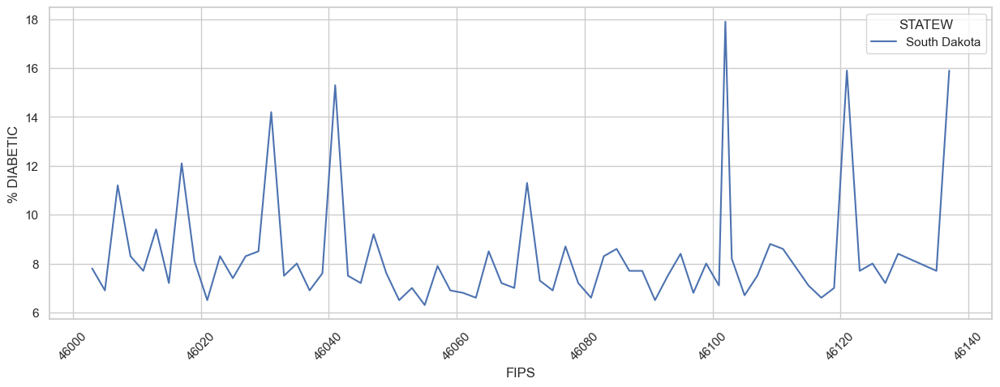

In [43]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df1[df1['STATEW'].isin(['South Dakota'])], x='FIPS',y='% DIABETIC', hue='STATEW')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

# Let's Check differences by State for % OBESE

# % OBESE

In [44]:
sort_std = df2.groupby(['STATE']).describe()['% OBESE'].sort_values('std').index

each_state = df2.groupby(['STATE']).describe()['% OBESE'].sort_values('std')

each_state

,count,mean,std,min,25%,50%,75%,max
STATE,,,,,,,,
Nebraska,3.0,19.233333,0.251661,19.0,19.100,19.20,19.350,19.5
Louisiana,3.0,18.000000,0.300000,17.7,17.850,18.00,18.150,18.3
Mississippi,2.0,17.450000,0.353553,17.2,17.325,17.45,17.575,17.7
Montana,6.0,18.966667,0.355903,18.5,18.675,19.05,19.275,19.3
Missouri,10.0,18.870000,0.452278,18.4,18.500,18.75,19.300,19.5
Tennessee,10.0,18.930000,0.457165,18.0,18.750,19.00,19.275,19.4
Michigan,4.0,18.900000,0.476095,18.2,18.800,19.10,19.200,19.2
Texas,139.0,18.269784,0.509142,17.1,18.000,18.20,18.550,19.5
Pennsylvania,5.0,18.560000,0.705691,17.7,17.900,18.90,19.100,19.2


# TOP 5

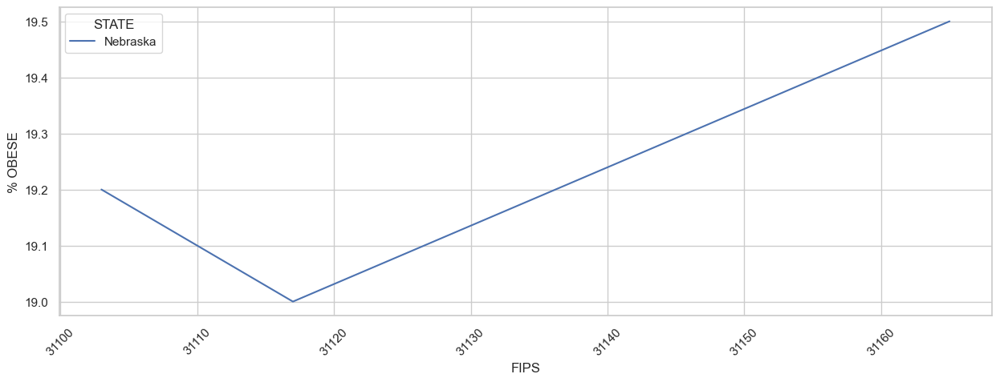

In [45]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df2[df2['STATE'].isin(['Nebraska'])], x='FIPS',y='% OBESE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

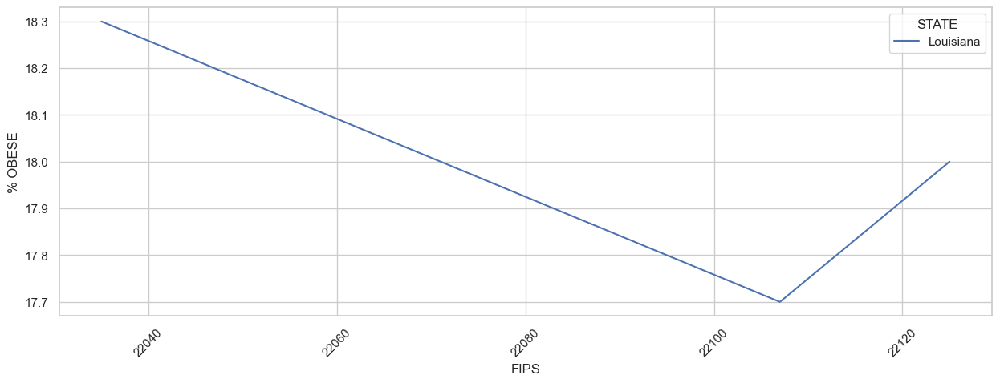

In [46]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df2[df2['STATE'].isin(['Louisiana'])], x='FIPS',y='% OBESE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

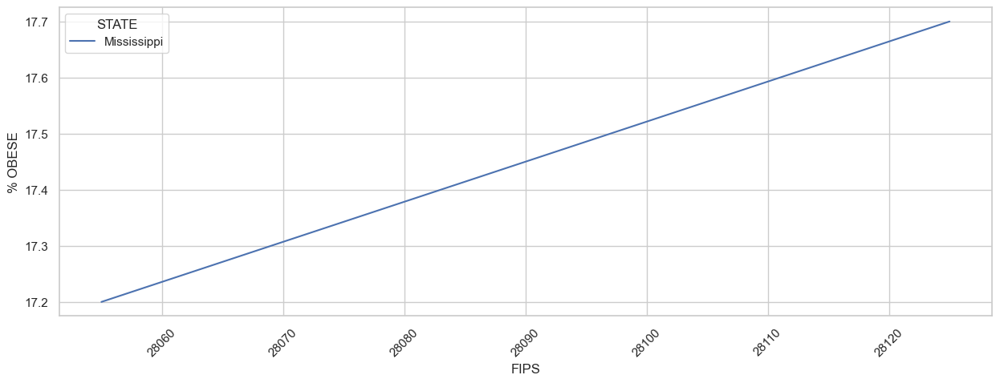

In [47]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df2[df2['STATE'].isin(['Mississippi'])], x='FIPS',y='% OBESE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

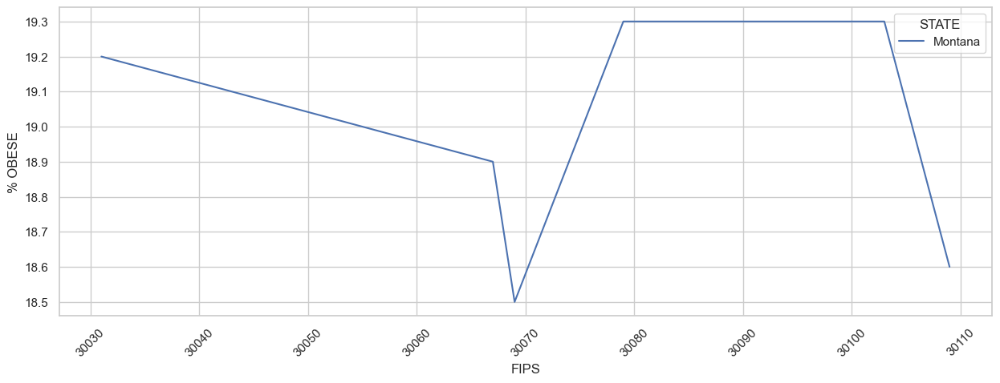

In [48]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df2[df2['STATE'].isin(['Montana'])], x='FIPS',y='% OBESE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

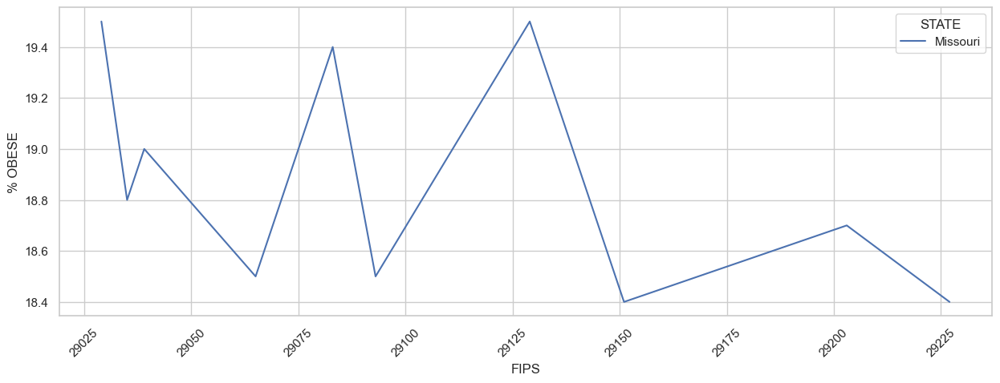

In [49]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df2[df2['STATE'].isin(['Missouri'])], x='FIPS',y='% OBESE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

# Bottom 5

Standard Deviation is NAN - So No Plots

# Let's Check differences by State for % INACTIVE

# % INACTIVE

In [50]:
sort_std = df3.groupby(['STATE']).describe()['% INACTIVE'].sort_values('std').index

each_state = df3.groupby(['STATE']).describe()['% INACTIVE'].sort_values('std')

each_state

,count,mean,std,min,25%,50%,75%,max
STATE,,,,,,,,
Florida,3.0,18.600000,0.624500,17.9,18.350,18.80,18.950,19.1
Rhode Island,3.0,17.433333,0.709460,16.8,17.050,17.30,17.750,18.2
New Hampshire,5.0,18.240000,0.743640,17.4,17.900,18.10,18.400,19.4
Connecticut,5.0,17.480000,1.089495,16.4,16.700,17.50,17.600,19.2
Indiana,11.0,17.627273,1.094615,16.1,16.950,17.80,18.100,19.5
Arkansas,6.0,18.500000,1.099091,16.8,17.825,18.90,19.300,19.5
Minnesota,40.0,17.730000,1.143589,15.0,17.050,17.85,18.700,19.3
Alabama,4.0,17.475000,1.220314,16.8,16.800,16.90,17.575,19.3
Massachusetts,9.0,16.788889,1.359636,14.8,15.500,16.80,17.800,18.8


In [51]:
df3.head()

,YEAR,FIPDS,COUNTY,STATE,% INACTIVE
0,2018,1011,Bullock County,Alabama,17.0
1,2018,1029,Cleburne County,Alabama,19.3
2,2018,1037,Coosa County,Alabama,16.8
3,2018,1063,Greene County,Alabama,16.8
4,2018,2013,Aleutians East Borough,Alaska,19.2


# For Florida

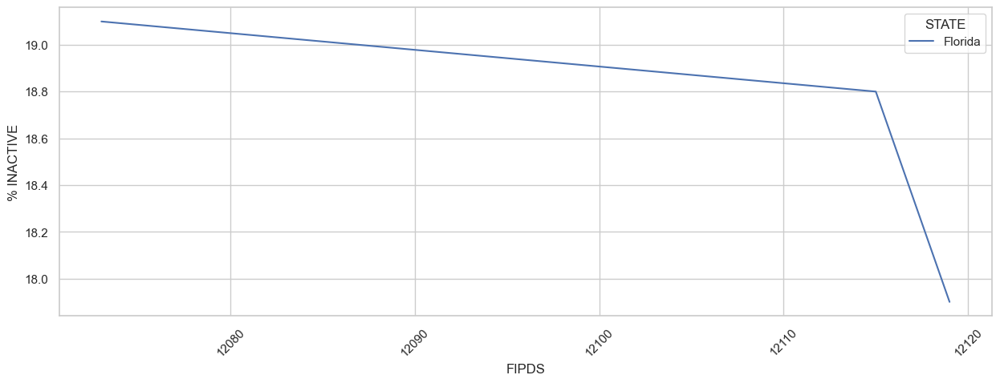

In [52]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df3[df3['STATE'].isin(['Florida'])], x='FIPDS',y='% INACTIVE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

# For Rhode Island

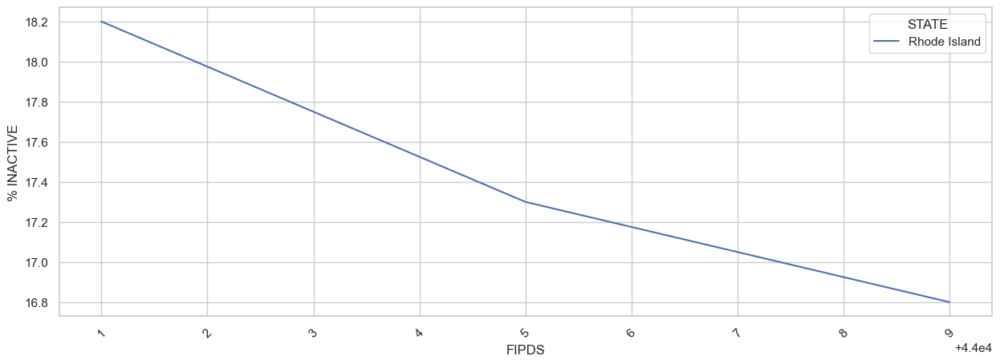

In [53]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df3[df3['STATE'].isin(['Rhode Island'])], x='FIPDS',y='% INACTIVE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

# For Massachusetts

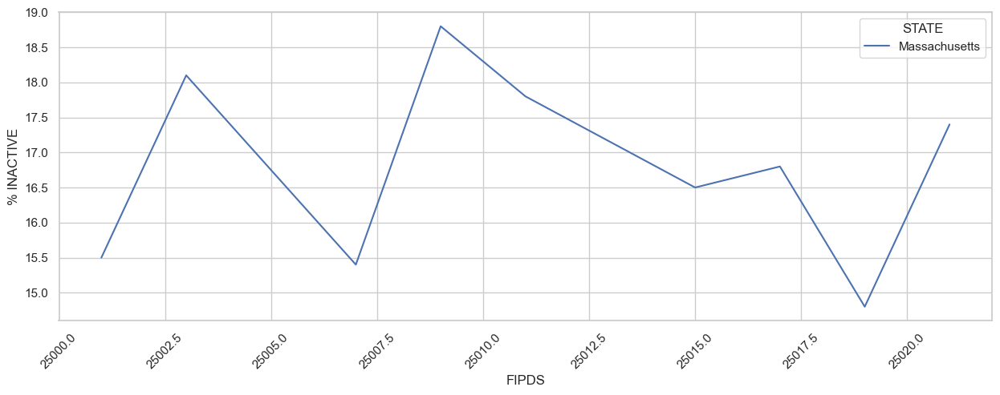

In [54]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df3[df3['STATE'].isin(['Massachusetts'])], x='FIPDS',y='% INACTIVE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

# For New Mexico

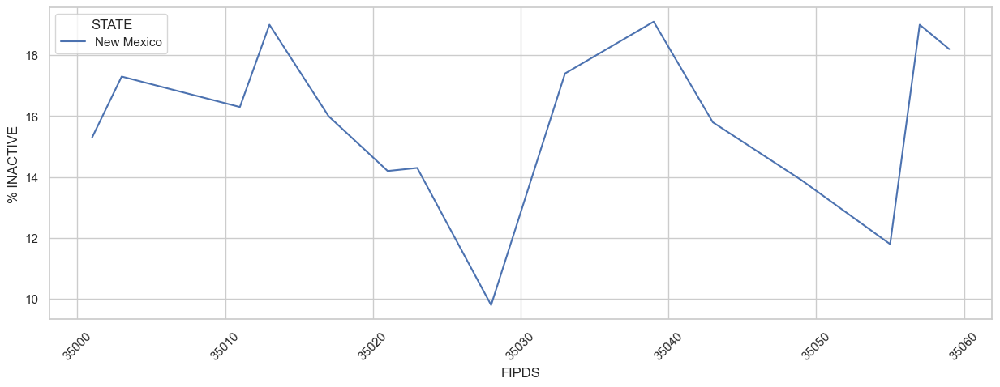

In [55]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df3[df3['STATE'].isin(['New Mexico'])], x='FIPDS',y='% INACTIVE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

# For Wyoming

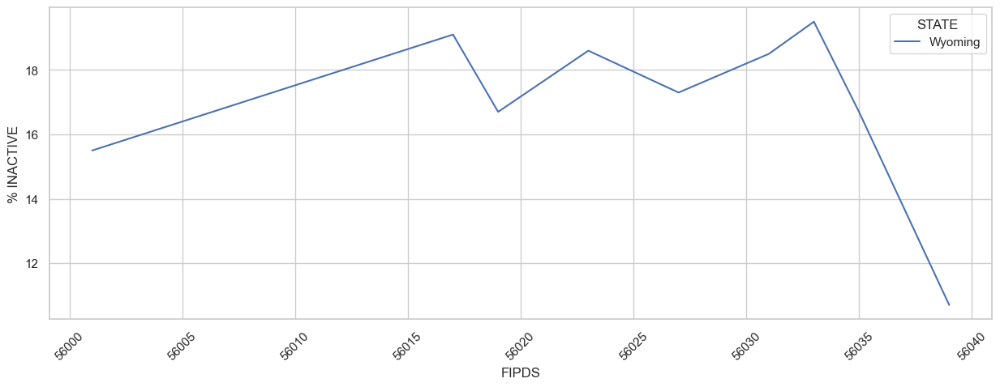

In [56]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df3[df3['STATE'].isin(['Wyoming'])], x='FIPDS',y='% INACTIVE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

# For Colorado

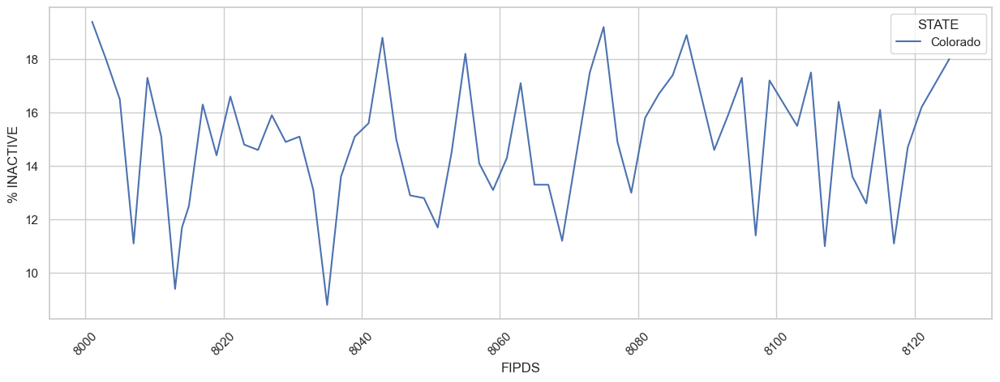

In [57]:
plt.figure(figsize=(15,5))
sns.lineplot(data=df3[df3['STATE'].isin(['Colorado'])], x='FIPDS',y='% INACTIVE', hue='STATE')
locs,labels = plt.xticks()
plt.setp(labels, rotation=45)
plt.show()

# Let's visualized distribution of our feature

In [58]:
import scipy.stats as stats

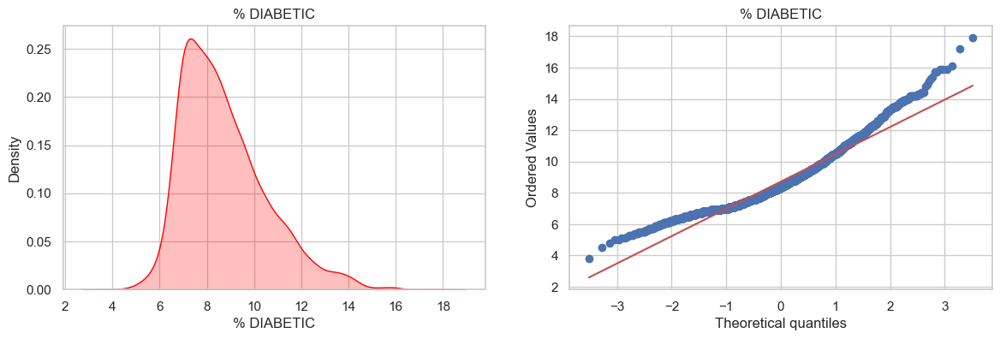

In [59]:
plt.figure(figsize=(14,4))
plt.subplot(121)
sns.kdeplot(df1['% DIABETIC'], shade=True, color='red')
plt.title('% DIABETIC')

plt.subplot(122)
stats.probplot(df1['% DIABETIC'],dist="norm", plot=plt)
plt.title('% DIABETIC')
plt.show();

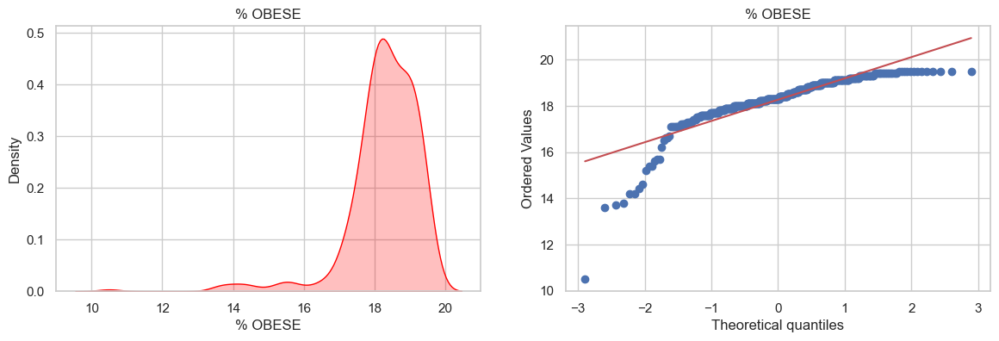

In [60]:
plt.figure(figsize=(14,4))
plt.subplot(121)
sns.kdeplot(df2['% OBESE'], shade=True, color='red')
plt.title("% OBESE")

plt.subplot(122)
stats.probplot(df2['% OBESE'],dist="norm", plot=plt)
plt.title("% OBESE")
plt.show();

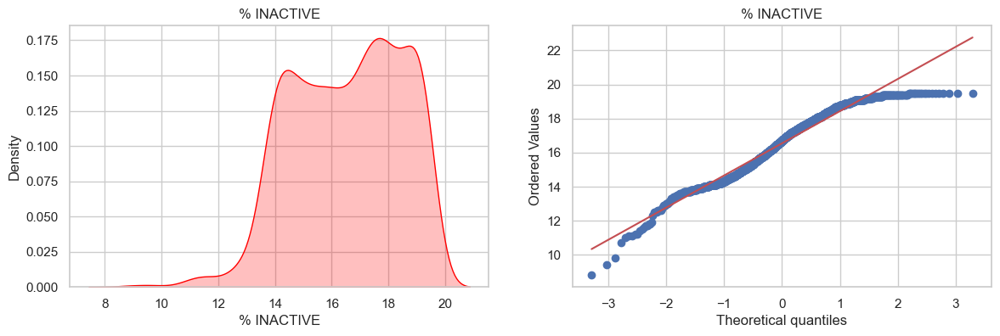

In [61]:
plt.figure(figsize=(14,4))
plt.subplot(121)
sns.kdeplot(df3['% INACTIVE'], shade=True, color='red')
plt.title("% INACTIVE")

plt.subplot(122)
stats.probplot(df3['% INACTIVE'],dist="norm", plot=plt)
plt.title("% INACTIVE")
plt.show();

There's a lot of Skewness in the Data, our data is mostly left-skewed and some features are right skewed. We need to perform tranformation on the features as they skewness suggests high kurtosis and also this can lead a huge problem in our model.

# Box - Cox Transformation

## FOR DIABETES

In [62]:
#Applying Box-Cox Tranform
pt = PowerTransformer(method='box-cox')
df1_transformed = pt.fit_transform(1+df1["% DIABETIC"].to_numpy().reshape(-1, 1))
df1_transformed = pd.DataFrame(df1_transformed, columns=['% DIABETIC'])
pd.DataFrame({'cols':"% DIABETIC", 'Box_Cox_lamdas':pt.lambdas_})

,cols,Box_Cox_lamdas
0,% DIABETIC,-0.982737


In [63]:
df1_transformed.head()

,% DIABETIC
0,0.603006
1,-0.016331
2,2.068290
3,0.934292
4,1.064029


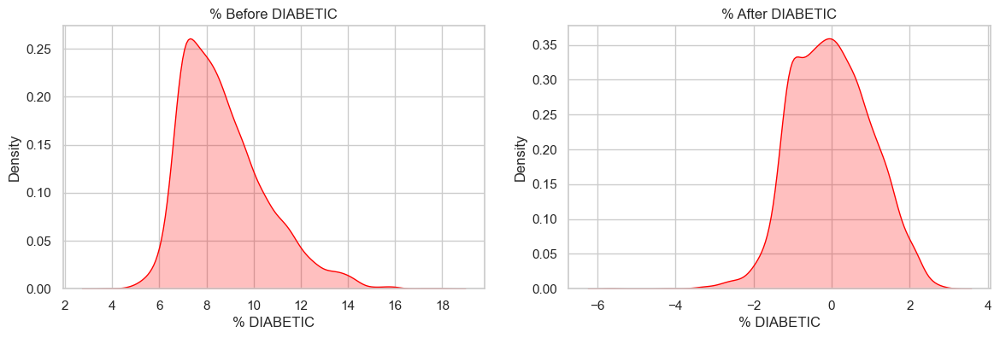

In [64]:
plt.figure(figsize=(14,4))
plt.subplot(121)
sns.kdeplot(df1["% DIABETIC"],shade=True, color='red')
plt.title("% Before DIABETIC")

plt.subplot(122)
sns.kdeplot(df1_transformed['% DIABETIC'],shade=True, color='red')
plt.title("% After DIABETIC")

plt.show()

## FOR OBESITY

In [65]:
#Applying Box-Cox Tranform
pt = PowerTransformer(method='box-cox')
df2_transformed = pt.fit_transform(1+df2["% OBESE"].to_numpy().reshape(-1, 1))
df2_transformed = pd.DataFrame(df2_transformed, columns=['% OBESE'])
pd.DataFrame({'cols':"% OBESE", 'Box_Cox_lamdas':pt.lambdas_})

,cols,Box_Cox_lamdas
0,% OBESE,10.130292


In [66]:
df2_transformed.head()

,% OBESE
0,0.367667
1,0.694183
2,1.653615
3,-1.304219
4,-0.200955


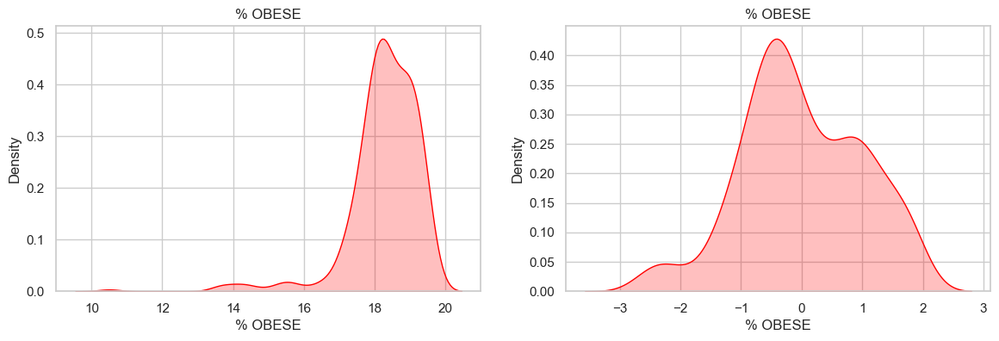

In [67]:
plt.figure(figsize=(14,4))
plt.subplot(121)
sns.kdeplot(df2["% OBESE"],shade=True, color='red')
plt.title("% OBESE")

plt.subplot(122)
sns.kdeplot(df2_transformed['% OBESE'],shade=True, color='red')
plt.title("% OBESE")

plt.show()

# INACTIVE

In [68]:
#Applying Box-Cox Tranform
pt = PowerTransformer(method='box-cox')
df3_transformed = pt.fit_transform(1+df3["% INACTIVE"].to_numpy().reshape(-1, 1))
df3_transformed = pd.DataFrame(df3_transformed, columns=['% INACTIVE'])
pd.DataFrame({'cols':"% INACTIVE", 'Box_Cox_lamdas':pt.lambdas_})

,cols,Box_Cox_lamdas
0,% INACTIVE,2.288737


In [69]:
df3_transformed.head()

,% INACTIVE
0,0.174055
1,1.537728
2,0.065378
3,0.065378
4,1.474027


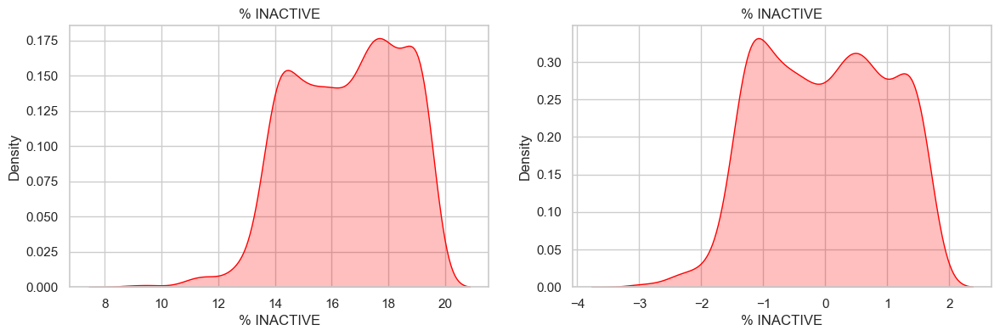

In [70]:
plt.figure(figsize=(14,4))
plt.subplot(121)
sns.kdeplot(df3["% INACTIVE"],shade=True, color='red')
plt.title("% INACTIVE")

plt.subplot(122)
sns.kdeplot(df3_transformed['% INACTIVE'],shade=True, color='red')
plt.title("% INACTIVE")

plt.show()

In [71]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

## VISUALIZING DIABETIC RATE ON UNITED STATES MAP

In [72]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

fig = px.choropleth_mapbox(df1, geojson=counties, locations='FIPS', color='% DIABETIC',
                           color_continuous_scale="thermal",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'% DIABETIC':'DIABETES RATE', 'COUNTY':'COUNTY'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## VISUALIZING OBSEITY RATE ON UNITED STATES MAP

In [73]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

fig = px.choropleth_mapbox(df2, geojson=counties, locations='FIPS', color='% OBESE',
                           color_continuous_scale="purples",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'% OBESE':'OBESITY RATE'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## VISUALIZING INACTIVITY RATE ON UNITED STATES MAP

In [74]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

fig = px.choropleth_mapbox(df3, geojson=counties, locations='FIPDS', color='% INACTIVE',
                           color_continuous_scale="blues",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'% INACTIVE':'INACTIVITY RATE'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [75]:
df1.columns

Index(['YEAR', 'FIPS', 'COUNTY', 'STATEW', '% DIABETIC'], dtype='object')

# FEATURE EXTRACTION

## Unique FIPS Code present in each dataframe

% Diabetic

In [76]:
df1['FIPS'].nunique()

3142

% Obesity

In [77]:
df2['FIPS'].nunique()

363

% Inactive

In [78]:
df3['FIPDS'].nunique()

1370

In [79]:
df3.rename(columns={'FIPDS':'FIPS'}, inplace=True)

# Let's merge all this dataset

In [80]:
features = pd.merge(df1,df3, how='outer', on='FIPS')

In [81]:
features = pd.merge(features, df2, how='outer', on='FIPS')

In [82]:
features = features.drop(['YEAR_y','COUNTY_y', 'STATE_x', 'YEAR', 'COUNTY', 'STATE_y',], axis=1)

In [83]:
features.rename(columns={'FIPDS':'FIPS', 'COUNTY_x': 'COUNTY', 'STATEW':'STATE', 'YEAR_x':'YEAR'}, inplace=True)

In [84]:
features['COUNTY_F'] = (features['COUNTY'] + features['STATE']).factorize()[0]
features['STATE_F'] = features['STATE'].factorize()[0]

In [85]:
features['% DIABETIC'] = df1_transformed['% DIABETIC']
features['% OBESE'] = df2_transformed['% OBESE']
features['% INACTIVE'] = df3_transformed['% INACTIVE']
features['STATE_CODE'] = features['FIPS'] // 1000
features['COUNTY_CODE'] = features['FIPS'] % 1000 

In [98]:
features.isnull().sum()

YEAR           0
FIPS           0
COUNTY         0
STATE          0
% DIABETIC     0
% INACTIVE     0
% OBESE        0
COUNTY_F       0
STATE_F        0
STATE_CODE     0
COUNTY_CODE    0
dtype: int64

# Function to impute missing values

In [87]:
def imputing_missing_column(dataframe):
    for column in dataframe.columns:
        if dataframe[column].isnull().sum() > 0:
            mean = dataframe[column].mean()
            std = dataframe[column].std()
            random_values = np.random.normal(loc=mean, scale=std, size=dataframe[column].isnull().sum())
            dataframe[column] = dataframe[column].fillna(pd.Series(random_values,index=dataframe[column][dataframe[column].isnull()].index))

In [88]:
imputing_missing_column(features)

features['% INACTIVE'] = features['% INACTIVE'].fillna(features['% INACTIVE'].mean())
features['% OBESE'] = features['% OBESE'].fillna(features['% OBESE'].mean())

In [89]:
features.isnull().sum()

YEAR           0
FIPS           0
COUNTY         0
STATE          0
% DIABETIC     0
% INACTIVE     0
% OBESE        0
COUNTY_F       0
STATE_F        0
STATE_CODE     0
COUNTY_CODE    0
dtype: int64

In [90]:
features.columns

Index(['YEAR', 'FIPS', 'COUNTY', 'STATE', '% DIABETIC', '% INACTIVE',
       '% OBESE', 'COUNTY_F', 'STATE_F', 'STATE_CODE', 'COUNTY_CODE'],
      dtype='object')

In [91]:
#Features we are using for Linear regression Analysis
X = features[['YEAR', 'FIPS', '% OBESE','% INACTIVE' ,'COUNTY_F', 'STATE_F', 'STATE_CODE', 'COUNTY_CODE']]
y = features['% DIABETIC']

#Split into Training set and Test set
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)

#linear regression model
model = LinearRegression()

#Fit the model
model.fit(x_train, y_train)

LinearRegression()

In [92]:
print(model.coef_)

[ 0.00000000e+00 -2.47476643e-04  5.37822263e-03 -7.05533452e-03
 -6.51676761e-04  2.98003490e-01 -2.43291501e-07 -4.18514235e-06]


In [93]:
print(model.intercept_)

0.7230919418351535


In [94]:
pd.DataFrame(model.coef_, X.columns, columns=['Coeff'])

,Coeff
YEAR,0.000000e+00
FIPS,-2.474766e-04
% OBESE,5.378223e-03
% INACTIVE,-7.055335e-03
COUNTY_F,-6.516768e-04
STATE_F,2.980035e-01
STATE_CODE,-2.432915e-07
COUNTY_CODE,-4.185142e-06


In [95]:
predictions = model.predict(x_test)

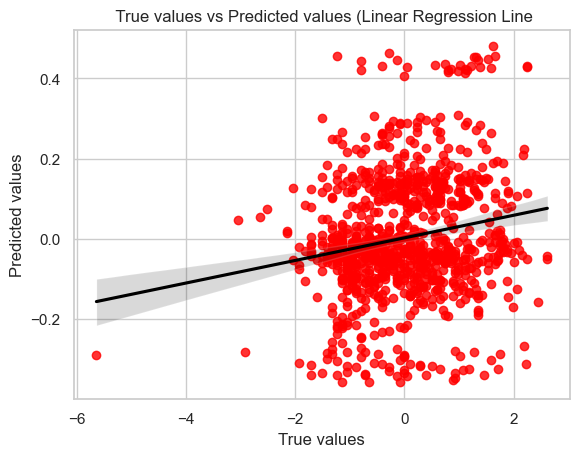

In [96]:
sns.regplot(y_test, predictions, scatter_kws={"color": "red"}, line_kws={"color": "black"})
plt.title(" True values vs Predicted values (Linear Regression Line")
plt.xlabel('True values')
plt.ylabel('Predicted values')
plt.show()

In [97]:
from sklearn import metrics
metrics.mean_absolute_error(y_test, predictions)

#MSE
print("The mean squared error value for our model: ",np.round(metrics.mean_squared_error(y_test, predictions),4))

#RMSE
print("The root mean squared error value for our model: ",np.round(np.sqrt(metrics.mean_squared_error(y_test, predictions)),4))

The mean squared error value for our model:  0.9385
The root mean squared error value for our model:  0.9688
